In [1]:
#!unzip K_means_Images.zip

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import  numpy.linalg as la
import cv2
import os

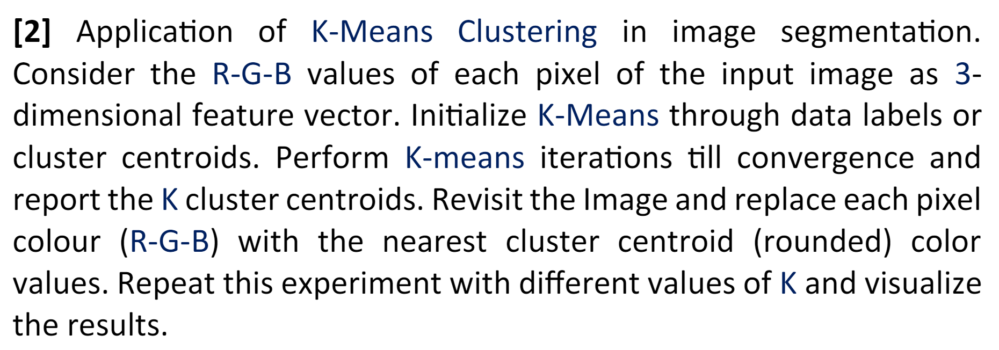

In [3]:
def load_images_from_folder(folder):
    images = []
    data_R = []
    data_G  =[]
    data_B = []
    count = 1
    list_images = sorted(os.listdir(folder))
    for filename in list_images:
        img = cv2.imread(os.path.join(folder,filename))

        images.append(img)

        R = img[:,:,0].reshape(-1)
        G = img[:,:,1].reshape(-1)
        B = img[:,:,2].reshape(-1)

        data_R.append(R)
        data_G.append(G)
        data_B.append(B)

        count+=1    
    images = np.array(images)   
    data_R = np.array(data_R) 
    data_G = np.array(data_G)
    data_B = np.array(data_B)   
    data = np.column_stack((data_R.reshape(-1),data_G.reshape(-1),data_B.reshape(-1)))
    print(data.shape)
    return images,data

In [4]:
def K_means(K,data,tol):
    labels = np.random.choice(np.arange(K),len(data),replace=True) 
    print(len(labels))
    all_unique_labels = np.unique(labels,return_counts = True)  
    print(all_unique_labels)

    if len(all_unique_labels[0]) != K:
        print("All unique labels not present.")
        return 
        
    # labels = np.zeros(len(data))
    # min_cluster_size = len(data)//K

    # for label in range(K):
    #     labels[label*min_cluster_size : (label+1)*min_cluster_size] = label

    # if K*min_cluster_size < len(data):
    #     labels[K*min_cluster_size:] = 0


    mean = []    
    for i in range(K):
        mean.append(np.mean(data[np.argwhere(labels == i)],axis=0).reshape(-1))

    mean = np.array(mean) 
    print(mean.shape)  
    pre_mean = np.zeros(shape = mean.shape)
    #print(la.norm((pre_mean - mean),axis = 1))
    while np.max(la.norm((pre_mean - mean),axis = 1)) > tol:
        pre_mean = np.copy(mean)
        for i in range(len(data)):
            labels[i] = np.argmin(la.norm((pre_mean - data[i]),axis = 1))

        mean = []    
        for i in range(K):
            mean.append(np.mean(data[np.argwhere(labels == i)],axis=0).reshape(-1))
        mean = np.array(mean)    
        print(np.max(la.norm((pre_mean - mean),axis = 1)))    
    return mean    

In [5]:
images,data = load_images_from_folder("K-means_Images")
Means = K_means(5,data,50)

(772005, 3)
772005
(array([0, 1, 2, 3, 4]), array([154529, 154572, 154408, 154610, 153886], dtype=int64))
(5, 3)


125.18724541835161
56.951351752333196
28.130152662877315


In [6]:
Means

array([[ 21.48824432, 190.62438613, 237.73615715],
       [114.42137018, 132.00406808, 136.7302885 ],
       [ 70.73530756, 104.55410452, 106.68674894],
       [215.46165229, 206.49434992, 187.24832634],
       [ 37.2361905 ,  48.44683512,  55.75096063]])

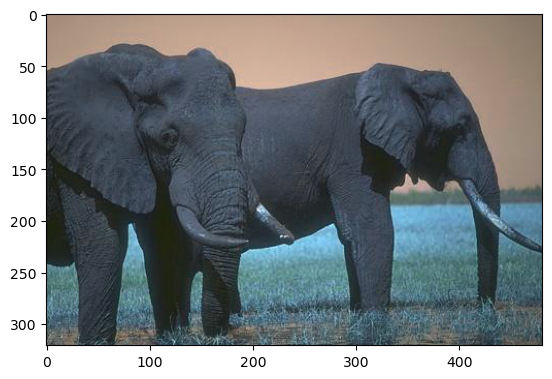

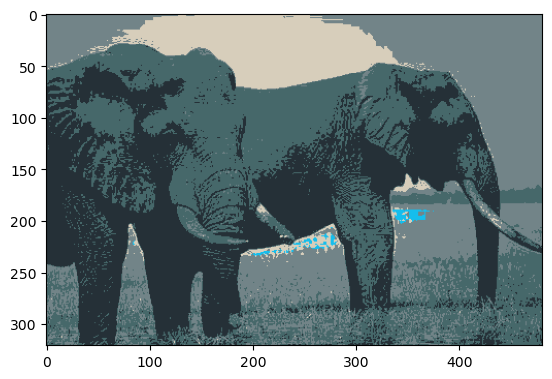

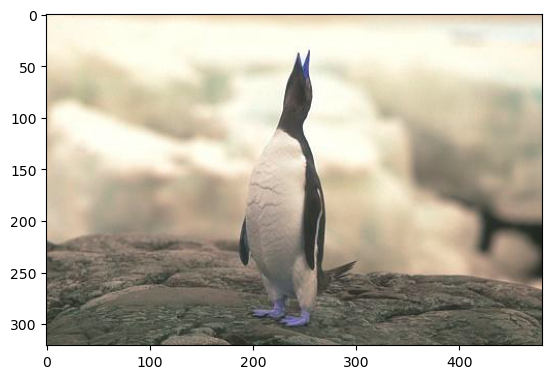

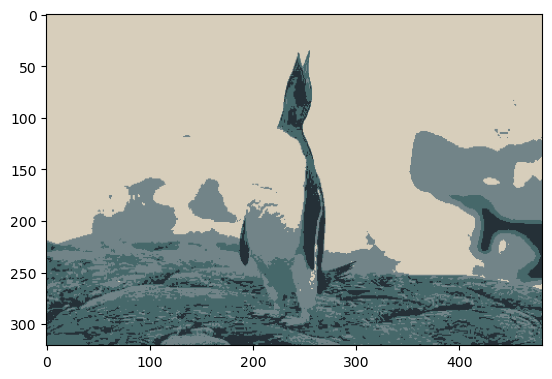

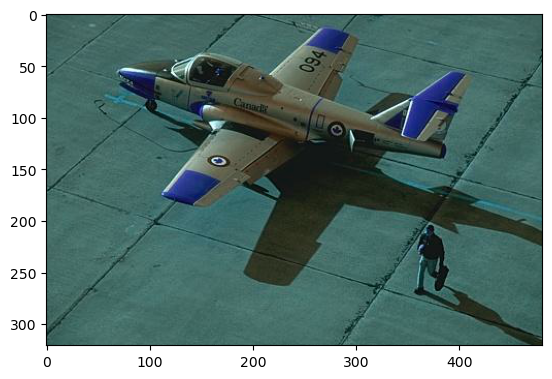

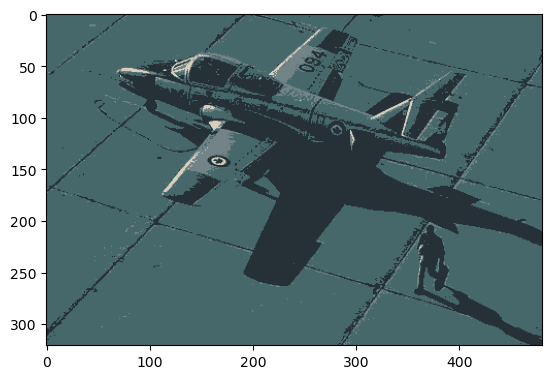

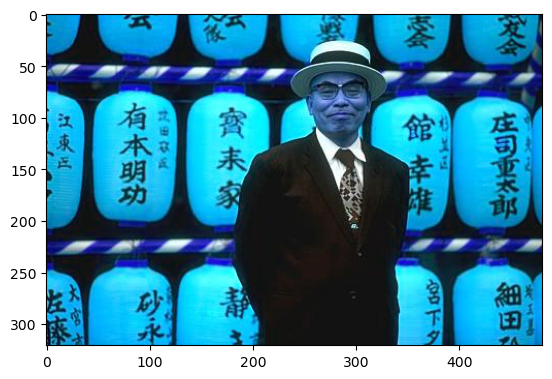

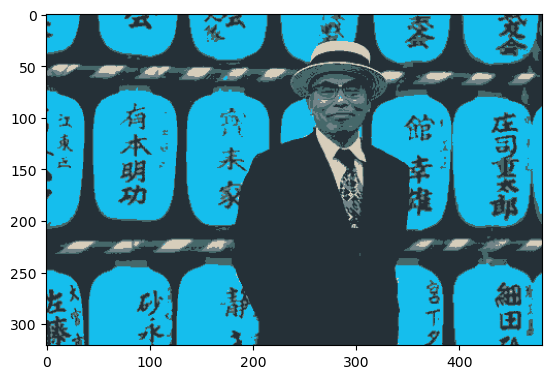

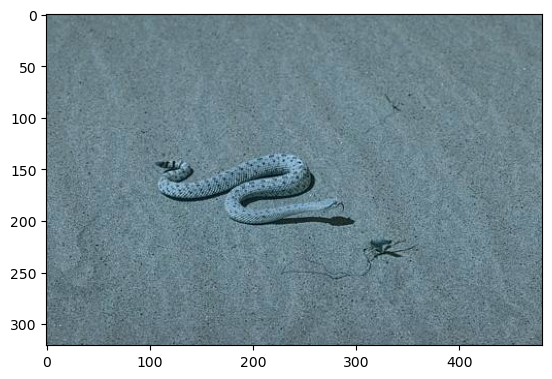

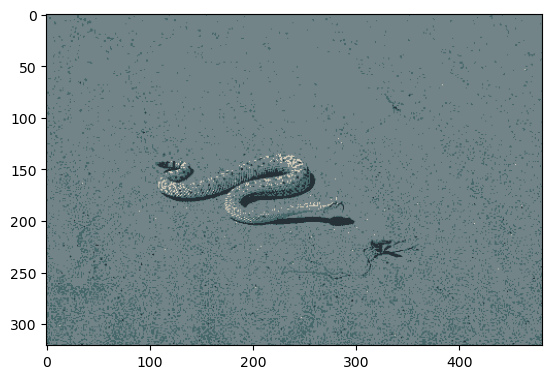

In [17]:
Segmented_images = []
shape = images[0].shape

for image in images: 
    new_image = []
    plt.imshow(image)
    plt.show()
    print("")
    for row in range(shape[0]):
        col_image = []
        for col in range(shape[1]):
            index = np.argmin(la.norm((image[row][col] - Means),axis = 1))
            pixels = Means[index].astype(int)
            col_image.append(pixels)
        new_image.append(np.array(col_image))
    new_image = np.array(new_image)    
    plt.imshow(np.array(new_image))
    plt.show()
    print("\n\n")

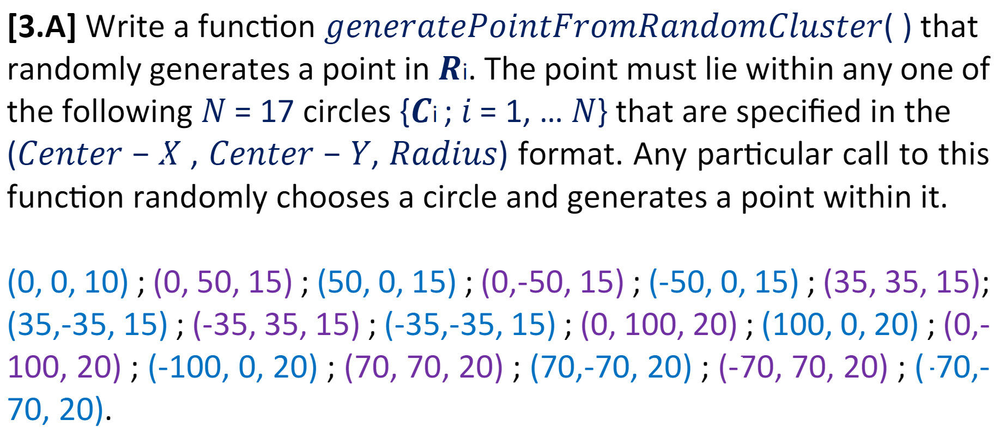

In [8]:
Circles = [(0,0,10),
           (0,50,15),(50,0,15),(0,-50,15),(-50,0,15),
           (35,35,15),(35,-35,15),(-35,35,15),(-35,-35,15),
           (0,100,20),(0,-100,20),(100,0,20),(-100,0,20),
           (70,70,20),(70,-70,20),(-70,70,20),(-70,-70,20)]

def generatePointFromRandomCluster():
    c_i = Circles[int(np.random.uniform(0,17,1)[0])]
    radius = np.random.random(1)*c_i[2]
    x_i = c_i[0]+radius
    y_i = c_i[1]+radius
    return np.array([x_i,y_i])
generatePointFromRandomCluster()

array([[103.42349095],
       [  3.42349095]])

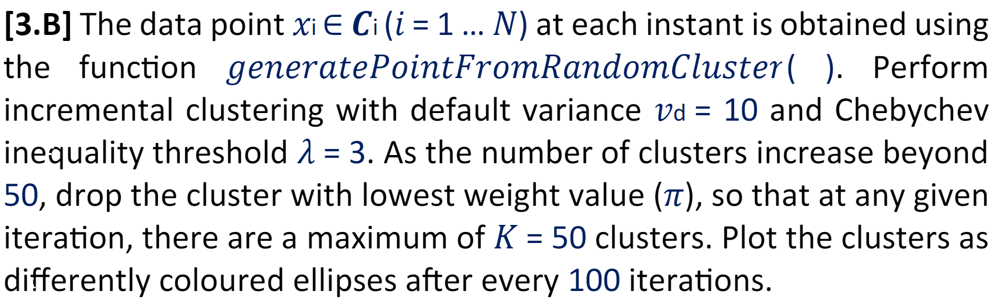

In [9]:
def New_cluster(cluster_set,x_t,cov,alpha):
    cluster_set.append([x_t,cov,alpha])
    return

In [10]:
def Update_Param(index,x_t,cluster_set,t):
    # calculate Beta value of cluster index 
    if t < 500:
        alpha_t = 1/t
    else:
        alpha_t = 1/500

    beta_index = alpha_t/cluster_set[index][2] 

    # Update mean
    pre_mean = cluster_set[index][0]
    cluster_set[index][0] = pre_mean*(1-beta_index) + beta_index*(x_t)

    # Update Co-var
    cluster_set[index][1] = (1 - beta_index)*(cluster_set[index][1] + beta_index*((x_t-pre_mean)@(x_t-pre_mean).T))    

    # Update Prior
    cluster_set[index][2] = (1 - 1/t)*cluster_set[index][2] + (1/t) 

    

    

In [11]:
lam = 3
Max_clusters = 50
plot_iter = 100
cluster_set = []
cov = np.array([[10,0],[0,10]]).T
t = 1
New_cluster(cluster_set,generatePointFromRandomCluster(),cov,1)
print(cluster_set)

[[array([[-84.4877418],
       [ 15.5122582]]), array([[10,  0],
       [ 0, 10]]), 1]]


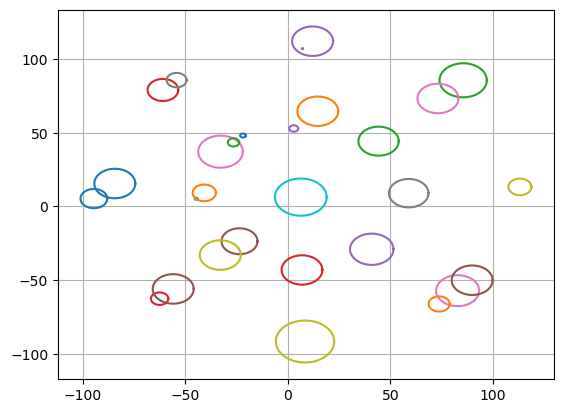

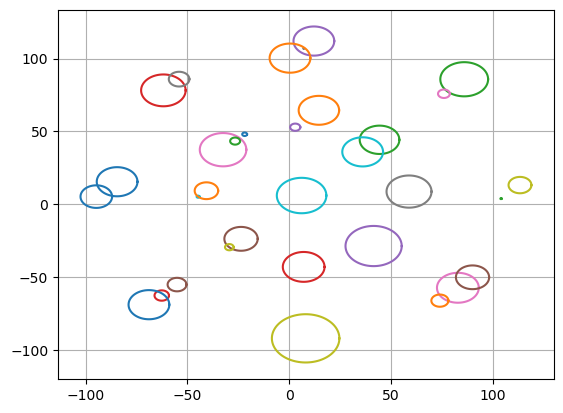

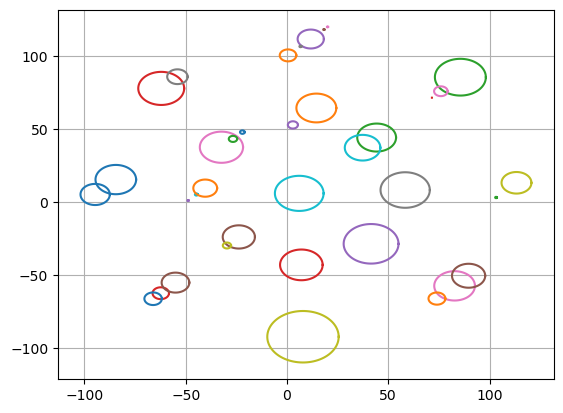

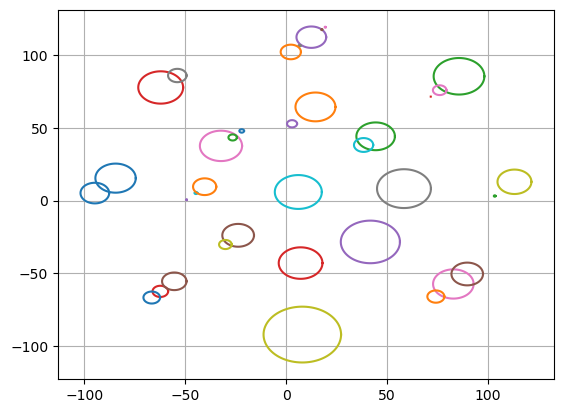

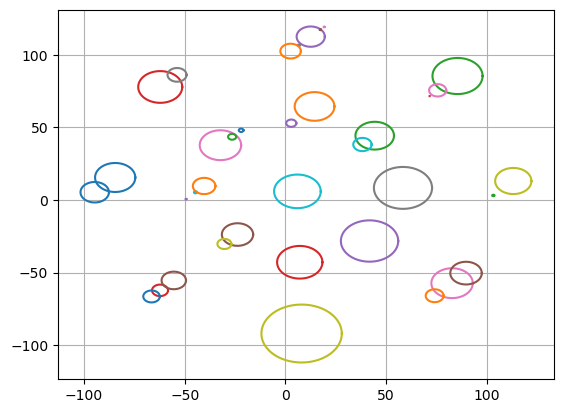

...

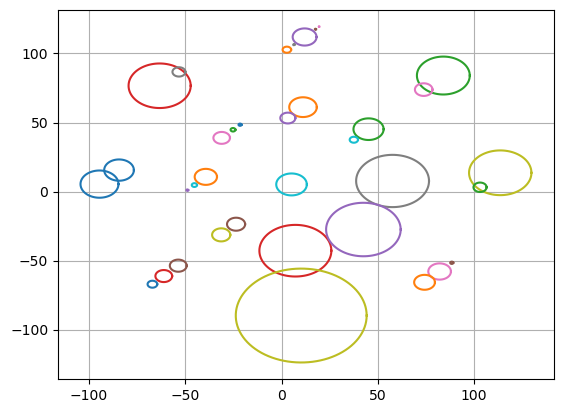

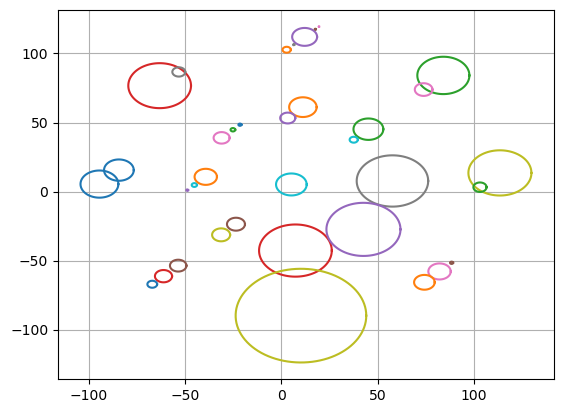

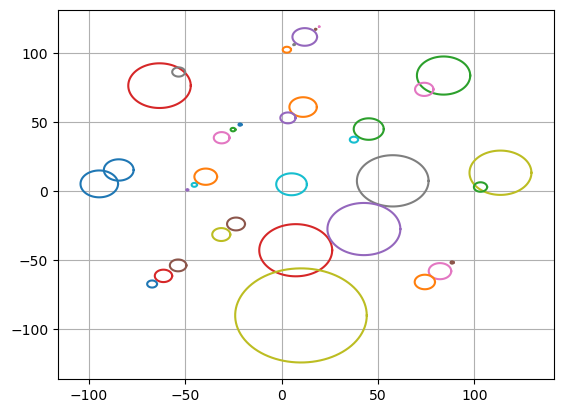

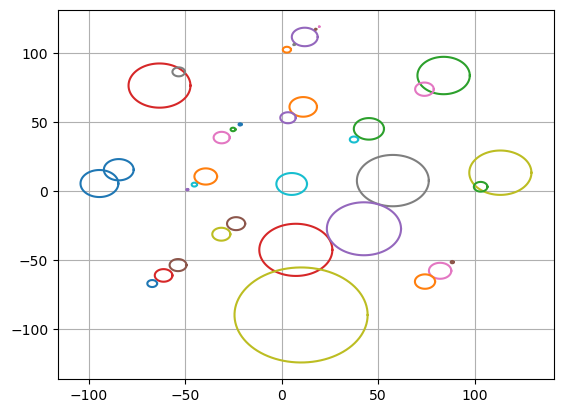

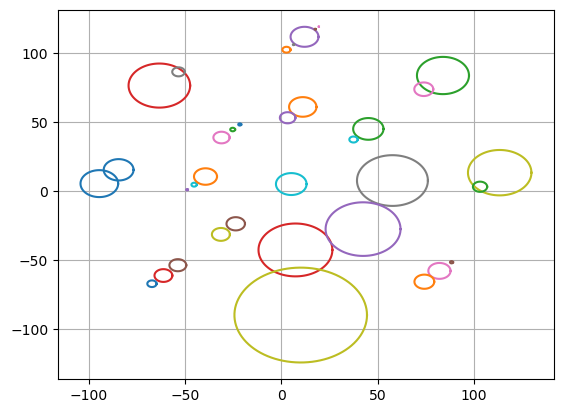

KeyboardInterrupt: 

In [12]:
while True:
    #print(len(cluster_set))
    
    x_t = generatePointFromRandomCluster()
    dist = []
    for i in range(len(cluster_set)):
        #print(cluster_set[i][1])
        d=(x_t - cluster_set[i][0]).T@la.inv(cluster_set[i][1])@(x_t - cluster_set[i][0])
        dist.append(d)
    dist = np.array(dist)    
    cluster_present = any(dist <= lam**2)
    if cluster_present:
        clust_index = np.argmin(dist)
        Update_Param(clust_index,x_t,cluster_set,t)
    else:
        if len(cluster_set) < Max_clusters:
            New_cluster(cluster_set,x_t,cov,1/t)
        else:
            min_alpha_index = np.argmin(np.array(cluster_set)[:,2])
            cluster_set.pop(min_alpha_index)
            if t < 500:
                New_cluster(cluster_set,x_t,cov,1/t)
            else:
                New_cluster(cluster_set,x_t,cov,1/500) 
    #print(t)            
    if t%100 == 0:
        print("\n")
        for cluster in cluster_set:
            mean = cluster[0]
            cov = cluster[1]
            u=mean[0]   #x-position of the center
            v=mean[1]   #y-position of the center
            a=cov[0][0]     #radius on the x-axis
            b=cov[1][1]    #radius on the y-axis

            t_ = np.linspace(0, 2*np.pi, 100)
            plt.plot( u+a*np.cos(t_) , v+b*np.sin(t_) )
        
        plt.grid()
        plt.show()
    t+=1            

In [ ]:
print(len(cluster_set))

44


In [ ]:
print(t)

19700
